In [1]:
# Project Time Series Workflowsplit the data, feature engineer the data and modeling


In [2]:
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels as sm
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from statsmodels.tsa.ar_model import AutoReg
# from statsmodels.tsa.ar_model import AutoReg

#from cleanup import clean_data
#from engineer import feature_engineer

# Load the data

In [3]:
df = pd.read_csv('tem.txt', sep=",", header=14, skipinitialspace=True, index_col=[1], parse_dates=True)
df.columns

Index(['SOUID', 'TG', 'Q_TG'], dtype='object')

In [4]:
df.describe()

,SOUID,TG,Q_TG
count,53691.000000,53691.000000,53691.000000
mean,119308.449312,57.461101,0.032687
std,8022.969883,612.236976,0.541406
min,111448.000000,-9999.000000,0.000000
25%,111448.000000,33.000000,0.000000
50%,111448.000000,94.000000,0.000000
75%,127488.000000,157.000000,0.000000
max,128124.000000,305.000000,9.000000


In [5]:
df.isnull().sum()

SOUID    0
TG       0
Q_TG     0
dtype: int64

In [6]:
df.duplicated().sum()

52574

In [7]:
df.replace(regex=r'^ba.$\n', value='new')
df

,SOUID,TG,Q_TG
DATE,,,
1876-01-01,127488,22,0
1876-01-02,127488,25,0
1876-01-03,127488,3,0
1876-01-04,127488,-58,0
1876-01-05,127488,-98,0
...,...,...,...
2022-12-27,111448,42,0
2022-12-28,111448,63,0
2022-12-29,111448,100,0


In [8]:
df.drop(df.columns[[0, 2]], axis=1, inplace=True)
df.head()

,TG
DATE,
1876-01-01,22
1876-01-02,25
1876-01-03,3
1876-01-04,-58
1876-01-05,-98


In [9]:
#df['TG'].unique
df.loc[:,'TG'] *= 0.1
df

,TG
DATE,
1876-01-01,2.2
1876-01-02,2.5
1876-01-03,0.3
1876-01-04,-5.8
1876-01-05,-9.8
...,...
2022-12-27,4.2
2022-12-28,6.3
2022-12-29,10.0


<AxesSubplot: xlabel='DATE'>

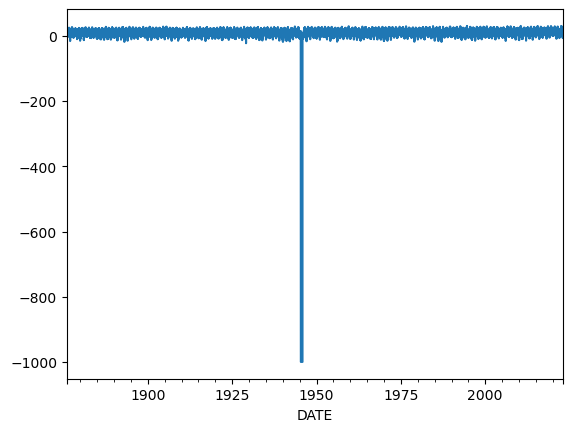

In [10]:
df.groupby('DATE')['TG'].mean().plot()

<AxesSubplot: xlabel='DATE'>

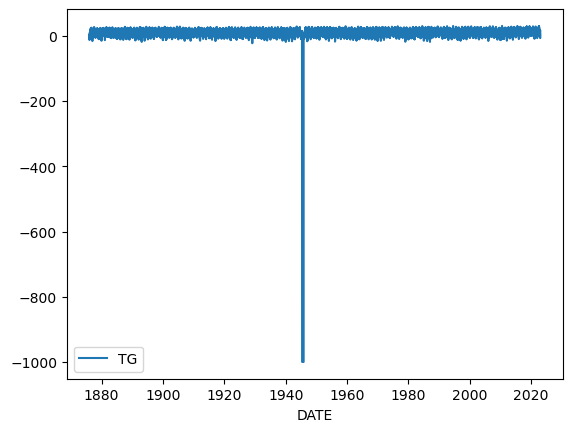

In [11]:
sns.lineplot(data = df)

<AxesSubplot: xlabel='DATE'>

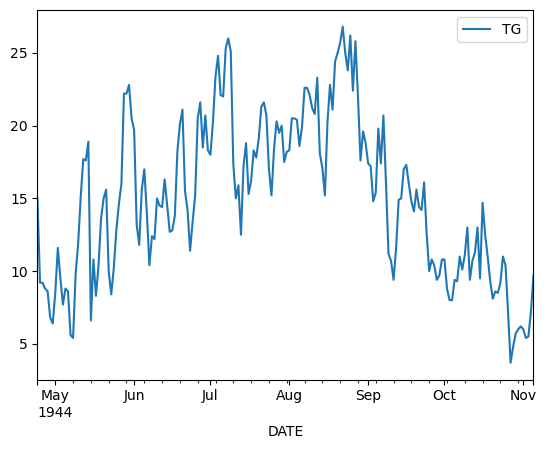

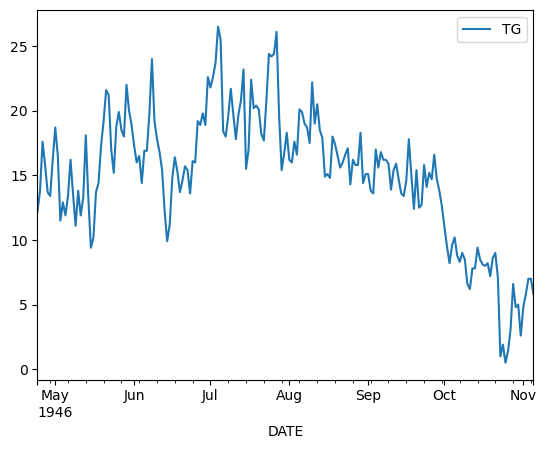

In [12]:
df.loc["24 April 1944":"5 November 1944"].plot()
df.loc["24 April 1946":"5 November 1946"].plot()

In [20]:
df.loc["24 April 1945":"5 November 1945"] = (df.loc["24 April 1944":"5 November 1944"].values + df.loc["24 April 1946":"5 November 1946"].values)/2
df.loc["24 April 1945":"5 November 1945"] = (df.loc["24 April 1943":"5 November 1943"].values + df.loc["24 April 1947":"5 November 1947"].values)/2 
df.loc["24 April 1945":"5 November 1945"] = (df.loc["24 April 1948":"5 November 1948"].values + df.loc["24 April 1949":"5 November 1949"].values)/2

In [22]:
df

,TG
DATE,
1876-01-01,2.2
1876-01-02,2.5
1876-01-03,0.3
1876-01-04,-5.8
1876-01-05,-9.8
...,...
2022-12-27,4.2
2022-12-28,6.3
2022-12-29,10.0


<AxesSubplot: xlabel='DATE'>

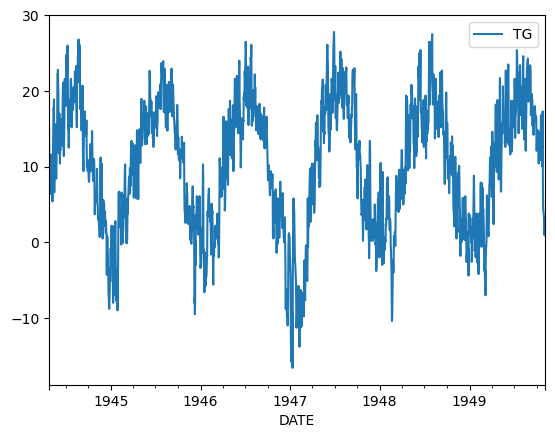

In [23]:
df.loc["24 April 1944":"5 November 1949"].plot()


In [24]:
def plot_df(df, title='yearly TG Numbers in 1000 over Time', ylim=True):
    '''
    Custom plotting function for plotting the Tem dataset
    
    Parameters
    ----------
    df : pd.DataFrame
        The data to plot.
    title : str
        The title of the plot
    ylim : bool
        Whether to fix the minimum value of y; defalut is True
    
    Returns
    -------
    Plots the data
    '''
    df.plot()
    plt.title(title)
    plt.ylabel('# of TG in 1000')
    if ylim:
        plt.ylim(ymin=0)
    plt.show()

In [25]:
list(range(len(df)))

[0,
 1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26,
 27,
 28,
 29,
 30,
 31,
 32,
 33,
 34,
 35,
 36,
 37,
 38,
 39,
 40,
 41,
 42,
 43,
 44,
 45,
 46,
 47,
 48,
 49,
 50,
 51,
 52,
 53,
 54,
 55,
 56,
 57,
 58,
 59,
 60,
 61,
 62,
 63,
 64,
 65,
 66,
 67,
 68,
 69,
 70,
 71,
 72,
 73,
 74,
 75,
 76,
 77,
 78,
 79,
 80,
 81,
 82,
 83,
 84,
 85,
 86,
 87,
 88,
 89,
 90,
 91,
 92,
 93,
 94,
 95,
 96,
 97,
 98,
 99,
 100,
 101,
 102,
 103,
 104,
 105,
 106,
 107,
 108,
 109,
 110,
 111,
 112,
 113,
 114,
 115,
 116,
 117,
 118,
 119,
 120,
 121,
 122,
 123,
 124,
 125,
 126,
 127,
 128,
 129,
 130,
 131,
 132,
 133,
 134,
 135,
 136,
 137,
 138,
 139,
 140,
 141,
 142,
 143,
 144,
 145,
 146,
 147,
 148,
 149,
 150,
 151,
 152,
 153,
 154,
 155,
 156,
 157,
 158,
 159,
 160,
 161,
 162,
 163,
 164,
 165,
 166,
 167,
 168,
 169,
 170,
 171,
 172,
 173,
 174,
 175,
 176,
 177,
 178,
 179,
 180,
 181,
 182,
 183,
 184,


In [28]:
# Create a monthly column for the trend
df['year'] = df.index.year
df.head()

,TG,yar,year
DATE,,,
1876-01-01,2.2,1876,1876
1876-01-02,2.5,1876,1876
1876-01-03,0.3,1876,1876
1876-01-04,-5.8,1876,1876
1876-01-05,-9.8,1876,1876


In [29]:
# Create a timestep variable
df['timestep'] = list(range(len(df)))
df.head()

,TG,yar,year,timestep
DATE,,,,
1876-01-01,2.2,1876,1876,0
1876-01-02,2.5,1876,1876,1
1876-01-03,0.3,1876,1876,2
1876-01-04,-5.8,1876,1876,3
1876-01-05,-9.8,1876,1876,4


In [30]:
df.columns

Index(['TG', 'yar', 'year', 'timestep'], dtype='object')

In [33]:
# Run a Linear Regression
m = LinearRegression()
# X = df[['month']] # Gave us a stepwise function without any obvious trend over time
X = df[['year']]
y =df.TG
m.fit(X, y)

LinearRegression()

In [34]:
# Use the model to make a prediction
df['trend'] = m.predict(X)
df.head(15)

,TG,yar,year,timestep,trend
DATE,,,,,
1876-01-01,2.2,1876,1876,0,8.533705
1876-01-02,2.5,1876,1876,1,8.533705
1876-01-03,0.3,1876,1876,2,8.533705
1876-01-04,-5.8,1876,1876,3,8.533705
1876-01-05,-9.8,1876,1876,4,8.533705
1876-01-06,-7.7,1876,1876,5,8.533705
1876-01-07,-6.6,1876,1876,6,8.533705
1876-01-08,-8.9,1876,1876,7,8.533705
1876-01-09,-12.7,1876,1876,8,8.533705


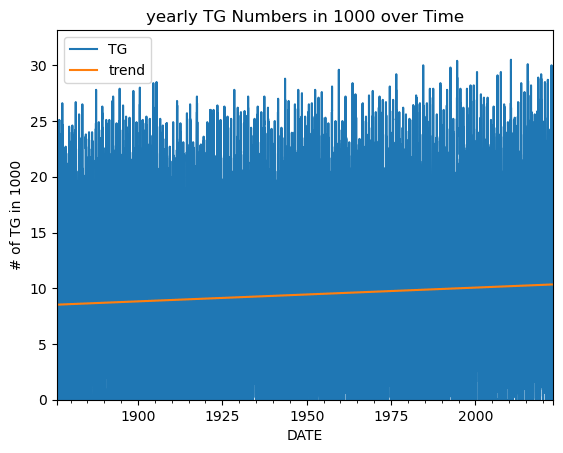

In [35]:
plot_df(df[['TG', 'trend']])

In [36]:
import plotly.express as px
px.scatter(df[['TG','trend']])

In [37]:
m.intercept_,m.coef_

(-14.628772437460166, array([0.01234674]))

### Stationary: A dataset should follow the below thumb rules without having Trend, Seasonality, Cyclical, and Irregularity components of the time series.

    The mean value of them should be completely constant in the data during the analysis.
    The variance should be constant with respect to the time-frame
    Covariance measures the relationship between two variables.

Non- Stationary: If either the mean-variance or covariance is changing with respect to time, the dataset is called non-stationary.

## Model the seasonality

In [39]:
# one-hot encode the months

pd.get_dummies(df.year,prefix='year')

,year_1876,year_1877,year_1878,year_1879,year_1880,year_1881,year_1882,year_1883,year_1884,year_1885,...,year_2013,year_2014,year_2015,year_2016,year_2017,year_2018,year_2019,year_2020,year_2021,year_2022
DATE,,,,,,,,,,,,,,,,,,,,,
1876-01-01,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1876-01-02,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1876-01-03,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1876-01-04,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1876-01-05,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-27,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
2022-12-28,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
2022-12-29,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1


In [40]:
# One-Hot-Encoding the month
seasonal_dummies = pd.get_dummies(df.year,prefix='year')
# sklearn.preprocessing.OneHotEncoder

df = df.join(seasonal_dummies)

In [41]:
# Define X and y
X = df.drop(columns=['TG', 'year', 'trend'])

In [42]:
X

,yar,timestep,year_1876,year_1877,year_1878,year_1879,year_1880,year_1881,year_1882,year_1883,...,year_2013,year_2014,year_2015,year_2016,year_2017,year_2018,year_2019,year_2020,year_2021,year_2022
DATE,,,,,,,,,,,,,,,,,,,,,
1876-01-01,1876,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1876-01-02,1876,1,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1876-01-03,1876,2,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1876-01-04,1876,3,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1876-01-05,1876,4,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-27,2022,53686,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
2022-12-28,2022,53687,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
2022-12-29,2022,53688,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1


In [43]:
y

DATE
1876-01-01     2.2
1876-01-02     2.5
1876-01-03     0.3
1876-01-04    -5.8
1876-01-05    -9.8
              ... 
2022-12-27     4.2
2022-12-28     6.3
2022-12-29    10.0
2022-12-30     7.6
2022-12-31    14.8
Name: TG, Length: 53691, dtype: float64

In [44]:
m.fit(X, y)

LinearRegression()

In [45]:
# Create a model with trend and seasonality
df['trend_seasonal'] = m.predict(X)
df.head()

,TG,yar,year,timestep,trend,year_1876,year_1877,year_1878,year_1879,year_1880,...,year_2014,year_2015,year_2016,year_2017,year_2018,year_2019,year_2020,year_2021,year_2022,trend_seasonal
DATE,,,,,,,,,,,,,,,,,,,,,
1876-01-01,2.2,1876,1876,0,8.533705,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,6.770127
1876-01-02,2.5,1876,1876,1,8.533705,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,6.784100
1876-01-03,0.3,1876,1876,2,8.533705,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,6.798073
1876-01-04,-5.8,1876,1876,3,8.533705,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,6.812047
1876-01-05,-9.8,1876,1876,4,8.533705,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,6.826020


## Plot the original data and the trend

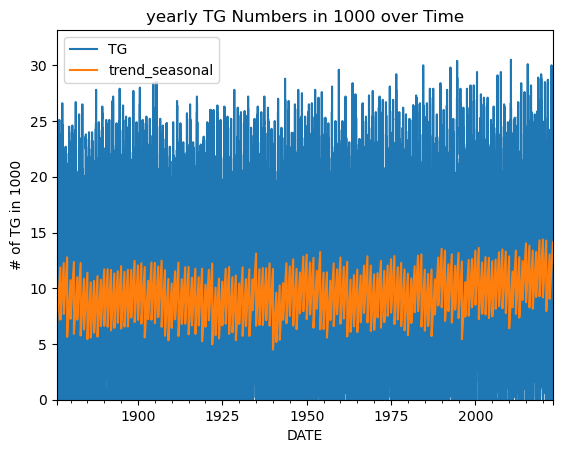

In [46]:
plot_df(df[['TG', 'trend_seasonal']])

In [47]:
px.scatter(df[['TG','trend_seasonal']])

In [48]:
df

,TG,yar,year,timestep,trend,year_1876,year_1877,year_1878,year_1879,year_1880,...,year_2014,year_2015,year_2016,year_2017,year_2018,year_2019,year_2020,year_2021,year_2022,trend_seasonal
DATE,,,,,,,,,,,,,,,,,,,,,
1876-01-01,2.2,1876,1876,0,8.533705,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,6.770127
1876-01-02,2.5,1876,1876,1,8.533705,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,6.784100
1876-01-03,0.3,1876,1876,2,8.533705,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,6.798073
1876-01-04,-5.8,1876,1876,3,8.533705,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,6.812047
1876-01-05,-9.8,1876,1876,4,8.533705,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,6.826020
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-27,4.2,2022,2022,53686,10.336329,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,14.071596
2022-12-28,6.3,2022,2022,53687,10.336329,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,14.085569
2022-12-29,10.0,2022,2022,53688,10.336329,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,14.099542


## Extract the remainder

In [49]:
df['remainder'] = df.TG - df.trend_seasonal

In [50]:
df.head(5)

,TG,yar,year,timestep,trend,year_1876,year_1877,year_1878,year_1879,year_1880,...,year_2015,year_2016,year_2017,year_2018,year_2019,year_2020,year_2021,year_2022,trend_seasonal,remainder
DATE,,,,,,,,,,,,,,,,,,,,,
1876-01-01,2.2,1876,1876,0,8.533705,1,0,0,0,0,...,0,0,0,0,0,0,0,0,6.770127,-4.570127
1876-01-02,2.5,1876,1876,1,8.533705,1,0,0,0,0,...,0,0,0,0,0,0,0,0,6.784100,-4.284100
1876-01-03,0.3,1876,1876,2,8.533705,1,0,0,0,0,...,0,0,0,0,0,0,0,0,6.798073,-6.498073
1876-01-04,-5.8,1876,1876,3,8.533705,1,0,0,0,0,...,0,0,0,0,0,0,0,0,6.812047,-12.612047
1876-01-05,-9.8,1876,1876,4,8.533705,1,0,0,0,0,...,0,0,0,0,0,0,0,0,6.826020,-16.626020


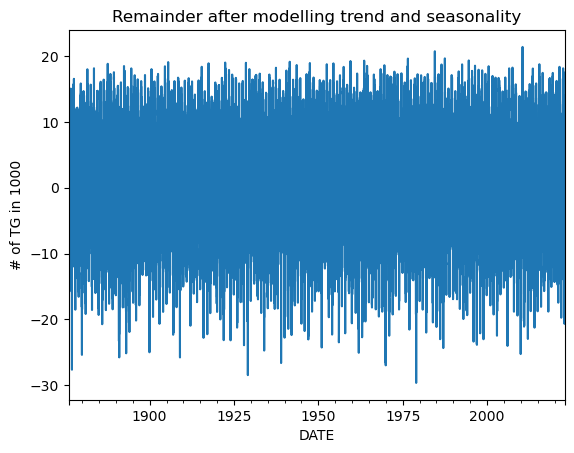

In [51]:
plot_df(df['remainder'], title='Remainder after modelling trend and seasonality', ylim=False)

In [52]:
px.scatter(df[['remainder']])

In [53]:
df['remainder'].mean(), df.remainder.std()

(8.356133968655392e-13, 7.681097069237026)

## Save the remainder

In [55]:
df['remainder'].to_csv('df_remainder_yearly.csv')